## Halbach optimization

Sweep Halbach function

In [1]:
import numpy as np
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import halbach_cylinder
import magpylib as magpy
from magpylib.magnet import Cylinder,CylinderSegment

def sweep_halbach(s_dict):
    """
    conf_dict:
        center_D: central big diameter to scan around
        dD: step size to scan big radius
        center_c_d: center cylinder diameter to scan around
        dcd: step size to scan cylinder diameter
        center_c_h: center cylinder height to scan around
        dch: step size to scan big height
        n_steps: number of steps
        min_N: min number of cylinders
        max_N: maximum number of cylinders
        alternate: flags whether or not to use on-axis or off-axis halbach
        scan_depth: number of times to repeat scan (optional)
        shrink_factor: factor to shrink step size on each repetition (optional)
        Br: absolute remanence value
        min_Bcenter: minimum center B field in Gauss
        max_Bcenter: maximum center B field in Gauss
        max_av_nonuniformity: maximum average nonuniformity
        x_bounds: grid bounds
        y_bounds: grid bounds
    """
    sweep = s_dict.copy()
    Br = sweep["Br"]
    grid = make_grid(sweep["x_bounds"], sweep["y_bounds"], sweep["grid_res"])
    if(("scan_depth" not in s_dict) or ("shrink_factor" not in s_dict)):
        sweep["shrink_factor"] = 1
        sweep["scan_depth"] = 1
    
    possible_confs = []
    for depth_i in range(sweep["scan_depth"]):
        D_sweep = centered_sweep_range(sweep["center_D"], sweep["D_steps"], sweep["dD"])
        c_d_sweep = centered_sweep_range(sweep["center_c_d"], sweep["c_d_steps"], sweep["dcd"])
        c_h_sweep = centered_sweep_range(sweep["center_c_h"], sweep["c_h_steps"], sweep["dch"])
        N_sweep = np.arange(sweep["min_N"], 1+sweep["max_N"])
#         startD = sweep["center_D"] + int(sweep["n_steps"] / 2) * sweep["dD"]
#         stopD = sweep["center_D"] - int(sweep["n_steps"] / 2) * sweep["dD"]
#         D_sweep = np.linspace(start=startD, stop=stopD, num=(sweep["n_steps"] + 1 if (sweep["n_steps"] % 2 == 0) else sweep["n_steps"]))
        for rem in Br:
            for D in D_sweep:
                for c_d in c_d_sweep:
                    for c_h in c_h_sweep:
                        for N in N_sweep:
                            magnets = halbach_cylinder(rem, c_d, c_h, D, int(N), alternate=True)
    #                         print(Br, c_d, c_h, D, int(N))
                            grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, sweep["grid_res"])
    #                         print(max_nonuniformity)
                            if (center_field > sweep["min_Bcenter"] and
                                av_nonuniformity < sweep["max_av_nonuniformity"] and
                                max_nonuniformity < sweep["max_abs_nonuniformity"] and 
                                center_field < sweep["max_Bcenter"]):
                                possible_confs.append(
                                    {"Br": rem,
                                     "c_d": c_d,
                                     "c_h": c_h,
                                     "D": D,
                                     "N": N,
                                     "av": av_nonuniformity,
                                     "max": max_nonuniformity,
                                     "Bcenter": center_field
                                    }
                                )

        #
        possible_confs.sort(key=lambda item: item.get("av"))
        print(possible_confs[:5])
        return possible_confs

## Sweep 1
Define sweep configuration and run sweep #1

In [2]:
s_dict = {
    "center_D": 80,
    "dD": 3,
    "D_steps": 24,
    "center_c_d": 4,
    "c_d_steps": 1,
    "dcd": 1,
    "center_c_h": 210,
    "c_h_steps": 1,
    "dch": 5,
#     "n_steps": 3,
    "min_N": 5,
    "max_N": 10,
    "alternate": True,
    "Br": [1.09e3, 0.68e3, 0.39e3],
    "min_Bcenter": 0.2,
    "max_Bcenter": 1000,
    "max_av_nonuniformity": 1e-4,
    "max_abs_nonuniformity": 1e-4,
    "x_bounds": [-6, 6],
    "y_bounds": [-5, 5],
    "grid_res": 101
#     scan_depth: number of times to repeat scan (optional)
#     shrink_factor: factor to shrink step size on each repetition (optional)
}

# 1.09 5.0 210.0 17.0 3
confs = sweep_halbach(s_dict)

[{'Br': 1090.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 7, 'av': 4.098248651706086e-06, 'max': 1.4186101067324661e-05, 'Bcenter': 315.07733045782635}, {'Br': 390.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 7, 'av': 4.098248651717656e-06, 'max': 1.41861010675548e-05, 'Bcenter': 112.73409071426815}, {'Br': 680.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 7, 'av': 4.098248651796511e-06, 'max': 1.418610106747323e-05, 'Bcenter': 196.56200432231373}, {'Br': 390.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 9, 'av': 4.099996511931552e-06, 'max': 1.4186101066280266e-05, 'Bcenter': 144.9438309183444}, {'Br': 680.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 9, 'av': 4.099996511937428e-06, 'max': 1.418610106630045e-05, 'Bcenter': 252.72257698583127}]


Best result from sweep

In [4]:
from maggeometry import halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
confs=[{'Br': 1090.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 7, 'av': 4.098248651706086e-06, 'max': 1.4186101067324661e-05, 'Bcenter': 315.07733045782635}]

On x-axis:
Maximum B-field: 7.046 G
Central B-field: 7.046 G
Min nonuniformity: 0.0
Max nonuniformity:0.00022733237204747699


On y-axis:
Maximum B-field: 7.046 G
Central B-field: 7.046 G
Min nonuniformity: 0.0
Max nonuniformity:5.807071680589383e-05


On z-axis:
Maximum B-field: 7.274 G
Central B-field: 7.046 G
Min nonuniformity: 0.0
Max nonuniformity:0.032377982753020715




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:152: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:157: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:162: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.



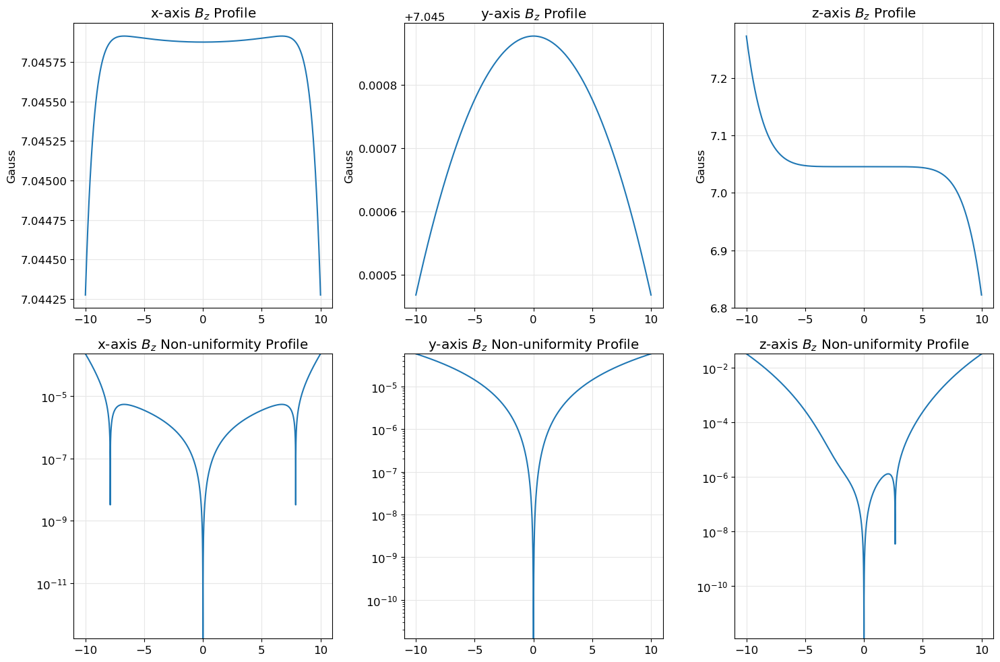

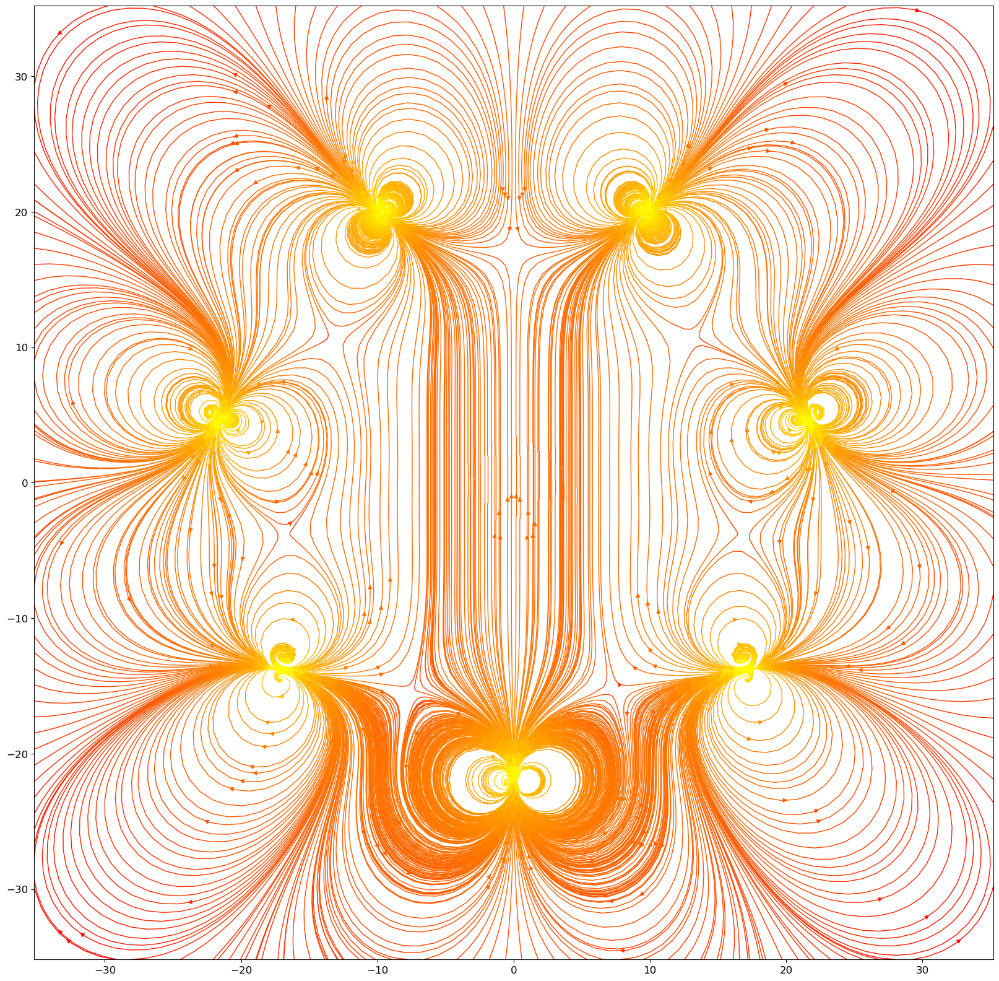

In [6]:
best_conf = confs[0]
magnets = halbach_cylinder(390,
#                            best_conf["Br"],
#                           best_conf["c_d"],
                           1,
                           best_conf["c_h"],
                           best_conf["D"],
                           best_conf["N"],
                           True)
D = best_conf["D"]
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [18]:
s_dict = {
    "center_D": 80,
    "dD": 3,
    "D_steps": 24,
    "center_c_d": 4,
    "c_d_steps": 1,
    "dcd": 1,
    "center_c_h": 210,
    "c_h_steps": 1,
    "dch": 5,
#     "n_steps": 3,
    "min_N": 5,
    "max_N": 10,
    "alternate": True,
    "Br": [1.09e3, 0.68e3, 0.39e3],
    "min_Bcenter": 0.2,
    "max_Bcenter": 1000,
    "max_av_nonuniformity": 1e-4,
    "max_abs_nonuniformity": 1e-4,
    "x_bounds": [-6, 6],
    "y_bounds": [-5, 5],
    "grid_res": 101
#     scan_depth: number of times to repeat scan (optional)
#     shrink_factor: factor to shrink step size on each repetition (optional)
}

# 1.09 5.0 210.0 17.0 3
confs = sweep_halbach(s_dict)

[]


## Halnach Nelder-Mead Optimization experiment #1
Optimizing for average nonuniformity over 4cm^2 area

In [63]:
from maggeometry import halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from scipy.optimize import minimize, Bounds

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)

def av_nonuniformity(x):
    D, c_d, c_h, N = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

def max_nonuniformity(x):
    D, c_d, c_h, N = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_nonuniformity

bounds = Bounds([10, 2, 160, 4], [40, 6, 210, 20])
# D, c_d, c_h, N
x0 = [32, 4, 180, 11]

# fatol is the absolute error between iterations that is acceptable for convergence
res = minimize(max_nonuniformity, x0, method="Nelder-Mead", options={'disp':True, 'fatol': 1e-16}, bounds=bounds)

print(res)

       message: Maximum number of function evaluations has been exceeded.
       success: False
        status: 1
           fun: 3.650534013711604e-05
             x: [ 3.887e+01  3.057e+00  2.100e+02  1.068e+01]
           nit: 268
          nfev: 800
 final_simplex: (array([[ 3.887e+01,  3.057e+00,  2.100e+02,  1.068e+01],
                       [ 3.887e+01,  3.057e+00,  2.100e+02,  1.068e+01],
                       ...,
                       [ 3.887e+01,  3.057e+00,  2.100e+02,  1.068e+01],
                       [ 3.887e+01,  3.057e+00,  2.100e+02,  1.068e+01]]), array([ 3.651e-05,  3.651e-05,  3.651e-05,  3.651e-05,
                        3.651e-05]))


/var/folders/06/7pjfbw510cz2ch1m7lx8vvl80000gn/T/ipykernel_31102/1971187266.py:26: RuntimeWarning:

Maximum number of function evaluations has been exceeded.



In [64]:
res = minimize(max_nonuniformity, x0, method="Powell", options={'disp':True}, bounds=bounds)

Optimization terminated successfully.
         Current function value: 0.000036
         Iterations: 4
         Function evaluations: 434


In [65]:
print(res)

 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 3.582765925616153e-05
       x: [ 3.870e+01  6.000e+00  2.100e+02  1.550e+01]
     nit: 4
   direc: [[ 0.000e+00  0.000e+00  0.000e+00  1.000e+00]
           [ 0.000e+00  1.000e+00  0.000e+00  0.000e+00]
           [ 0.000e+00  0.000e+00  1.000e+00  0.000e+00]
           [-1.870e+00 -6.608e-16  3.310e-07  8.704e-02]]
    nfev: 434


On x-axis:
Maximum B-field: 1572.542 G
Central B-field: 1572.535 G
Min nonuniformity: 0.0
Max nonuniformity:2.250992975980912e-05


On y-axis:
Maximum B-field: 1572.535 G
Central B-field: 1572.535 G
Min nonuniformity: 0.0
Max nonuniformity:3.0346855451271293e-05


On z-axis:
Maximum B-field: 1594.088 G
Central B-field: 1572.535 G
Min nonuniformity: 0.0
Max nonuniformity:0.013706018964787655




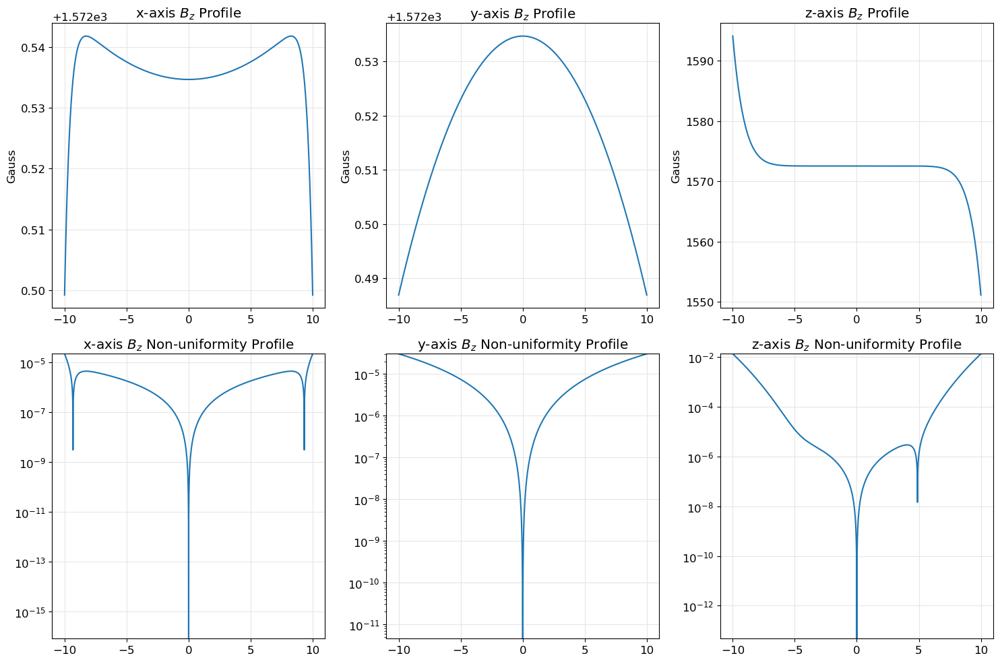

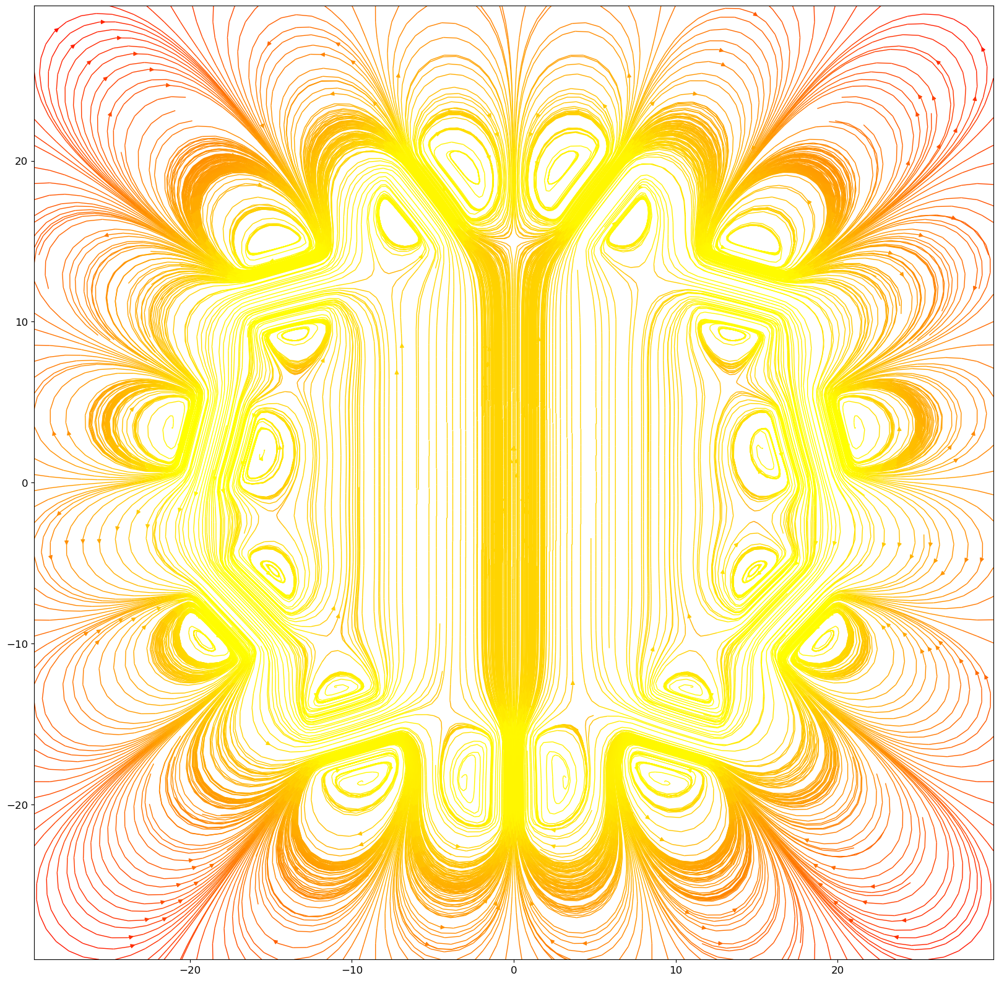

In [67]:
x = [ 3.704e+01,  6.000e+00,  2.100e+02,  1.060e+01]
D, c_d, c_h, N = x
# Br = 0.69e3
Br=1.09e3
# c_d = 0.5
# N=11
magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [8]:
bounds = Bounds([10, 2, 160, 4], [40, 6, 210, 12])
# D, c_d, c_h, N
x0 = [32, 4, 160, 9]

# fatol is the absolute error between iterations that is acceptable for convergence
res = minimize(nonuniformity, x0, method="Nelder-Mead", options={'disp':True, 'fatol': 1e-15}, bounds=bounds)

print(res)

Optimization terminated successfully.
         Current function value: 0.000015
         Iterations: 57
         Function evaluations: 143
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 1.538089404756512e-05
             x: [ 4.000e+01  6.000e+00  2.100e+02  9.338e+00]
           nit: 57
          nfev: 143
 final_simplex: (array([[ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       ...,
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00]]), array([ 1.538e-05,  1.538e-05,  1.538e-05,  1.538e-05,
                        1.538e-05]))


Maximum B-field along +z direction: 2.065 G
Central B-field along +z axis: 1.103 G
Maximum B-field along +x direction: 1.103 G
Central B-field along +x axis: 1.103 G
Min transverse nonuniformity: 0.0
Max transverse nonuniformity:2.4485735438436355e-06
Min axial nonuniformity: 0.0
Max axial nonuniformity:4.521988678988323e-05


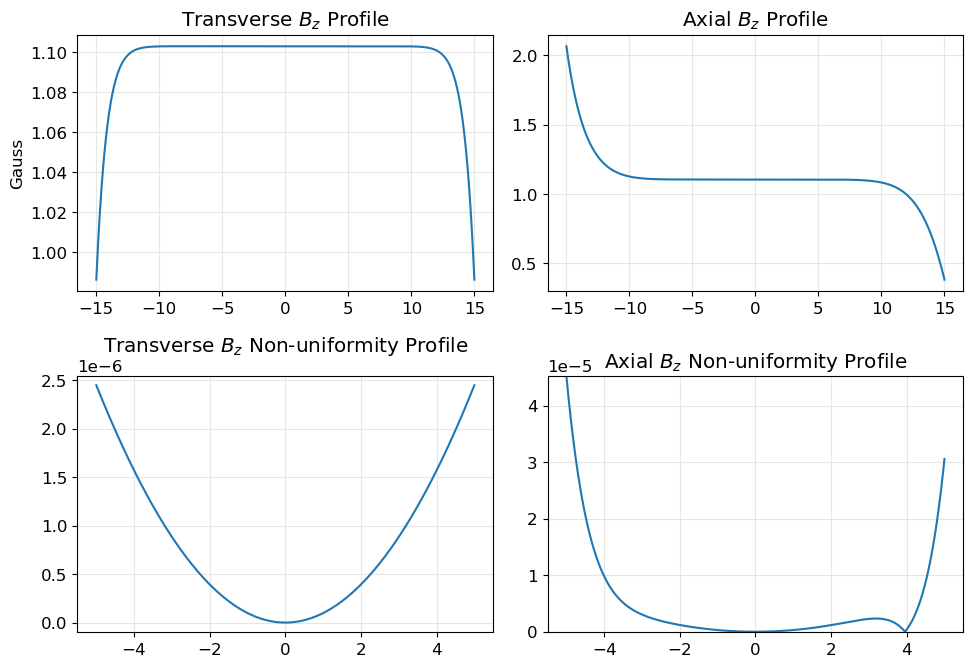

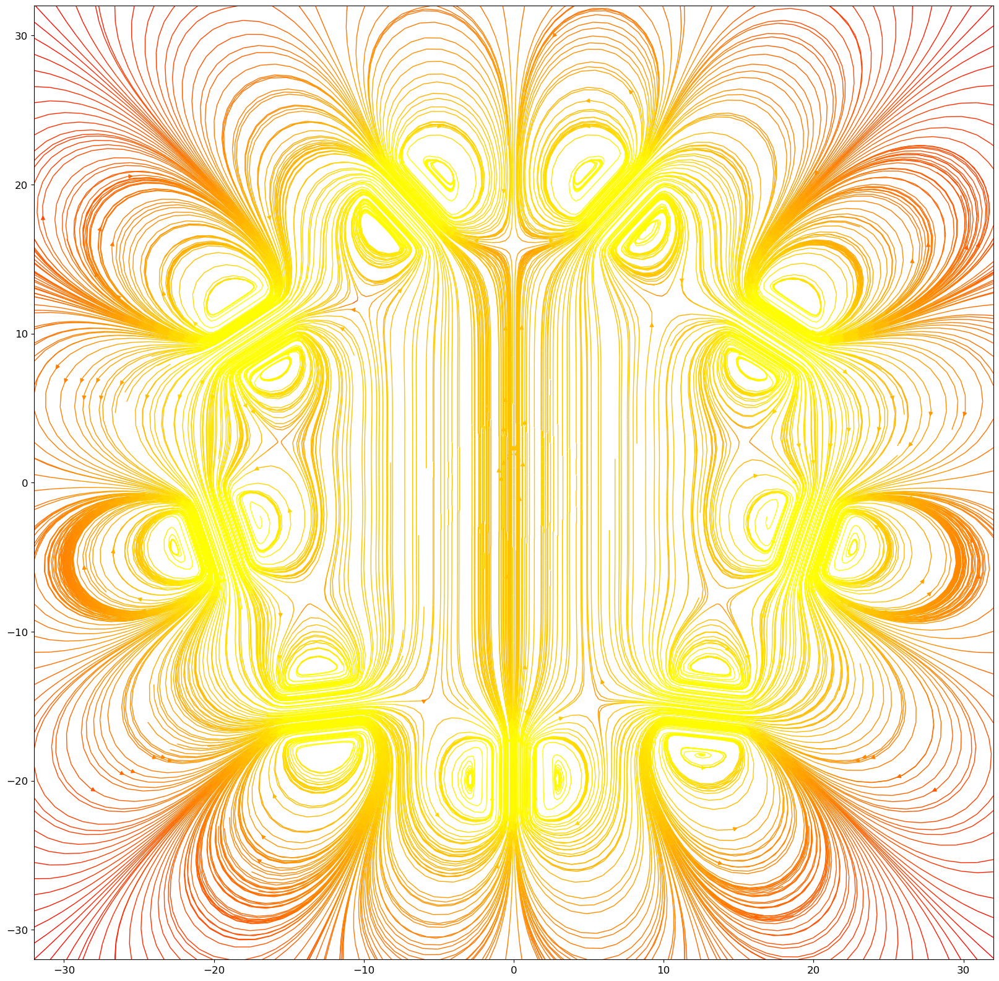

In [9]:
D, c_d, c_h, N = res.x
magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
x_len = 5
get_field_on_axes(magnets, D*0.75, D*0.75, [-x_len,x_len], [-x_len,x_len])

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [75]:
bounds = Bounds([10, 2, 160, 4], [40, 6, 210, 12])
# D, c_d, c_h, N
x0 = [32, 4, 160, 6]

# fatol is the absolute error between iterations that is acceptable for convergence
# res = minimize(nonuniformity, x0, method="trust-constr", options={'disp':True}, bounds=bounds)
# res = minimize(nonuniformity, x0, method="powell", options={'disp':True}, bounds=bounds)
# res = minimize(nonuniformity, x0, method="l-bfgs-b", options={'disp':True, 'ftol':1e-10, 'gtol':1e-10}, bounds=bounds)


       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 1.538089404756512e-05
             x: [ 4.000e+01  6.000e+00  2.100e+02  9.338e+00]
           nit: 57
          nfev: 143
 final_simplex: (array([[ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       ...,
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00],
                       [ 4.000e+01,  6.000e+00,  2.100e+02,  9.338e+00]]), array([ 1.538e-05,  1.538e-05,  1.538e-05,  1.538e-05,
                        1.538e-05]))


## Halnach Nelder-Mead Optimization experiment #2
Run from N = 1..12 and optimize each then plot results

In [27]:
from scipy.optimize import minimize, Bounds

def run_optimizer(min_N, max_N, x0, bounds, method, options):
    Br = 1.09e3
    grid_res = 101
    grid = make_grid([-10, 10], [-10, 10], grid_res)
    results = {}
    for i in range(min_N, 1+max_N):
        def max_nonuniformity(x):
            c_d, c_h, D = x
            magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(i)), alternate=True)
            grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
            return max_abs_nonuniformity
        res = minimize(max_nonuniformity, x0, method=method, options=options, bounds=bounds)
#         print(str(i), res)
        results[str(i)] = {"val": res.fun, "x": res.x}
    return results


In [40]:
bounds = Bounds([1, 160, 10], [2, 250, 40])
# c_d, c_h, D
x0 = [2, 160, 32]
options = {'disp':False, 'fatol': 1e-14}
method = "Nelder-mead"
min_N = 3
max_N = 25
results = run_optimizer(min_N, max_N, x0, bounds, method, options)
print(results)

{'3': {'val': 0.10630790916315809, 'x': array([  2., 250.,  40.])}, '4': {'val': 0.2803495384740311, 'x': array([  2., 250.,  40.])}, '5': {'val': 0.01073539497710094, 'x': array([  2., 250.,  40.])}, '6': {'val': 0.11265292557646221, 'x': array([  2., 250.,  40.])}, '7': {'val': 0.0009263143003514732, 'x': array([  2., 250.,  40.])}, '8': {'val': 0.034917235618847596, 'x': array([  2., 250.,  40.])}, '9': {'val': 8.317506300697891e-05, 'x': array([  2., 250.,  40.])}, '10': {'val': 0.010768340975815041, 'x': array([  2., 250.,  40.])}, '11': {'val': 1.6164188577730105e-05, 'x': array([  2.        , 249.99999323,  40.        ])}, '12': {'val': 0.0031837653369239352, 'x': array([  2., 250.,  40.])}, '13': {'val': 1.0934185129758441e-05, 'x': array([  2.        , 250.        ,  37.02836296])}, '14': {'val': 0.000919412582287539, 'x': array([  2., 250.,  40.])}, '15': {'val': 8.388212419139034e-06, 'x': array([  2.     , 250.     ,  34.56965])}, '16': {'val': 0.00027013212757566316, 'x': 

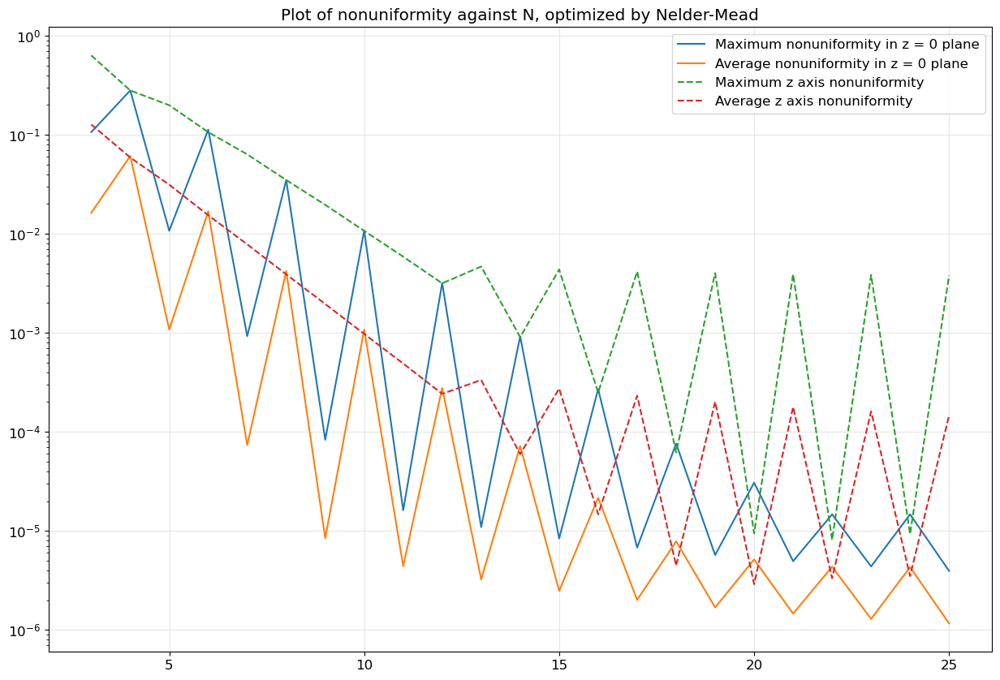

In [68]:
import numpy as np
import magpylib as magpy
import matplotlib.pyplot as plt

def get_z_nonuniformity(magnets):
    sens_res = 5000
    z_sensor_bounds = [-10, 10]
    z_senpos = np.linspace((0, 0, z_sensor_bounds[0]), (0, 0, z_sensor_bounds[1]), sens_res)
    z_sen = magpy.Sensor(position=z_senpos)
    z_Bz = z_sen.getB(magnets).T[2]
    mT_to_G = 10
    z_Gz = z_Bz * mT_to_G
    Gmag = z_Gz
    Gmax = max(Gmag)
    Gcenter = Gmag.item(int(len(Gmag)/2))
    Gnon = np.abs((Gmag - Gcenter)/Gcenter)
    min_nonuniformity = np.min(Gnon)
    max_nonuniformity = np.max(Gnon)
    av_nonuniformity = np.sum(Gnon) / sens_res
    return min_nonuniformity, max_nonuniformity, av_nonuniformity

n = np.arange(min_N,1+max_N)
max_non = []
av_non = []
maxz = []
minz = []
avz = []
Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
for i in range (min_N, 1+max_N):
#     max_non.append(results[str(i)]["val"])
    c_d, c_h, D = results[str(i)]["x"]
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(i)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    min_z_non, max_z_non, av_z_non = get_z_nonuniformity(magnets)
    av_non.append(av_nonuniformity)
    max_non.append(max_abs_nonuniformity)
    maxz.append(max_z_non)
    minz.append(min_z_non)
    avz.append(av_z_non)

plt.figure(figsize=(15, 10))
plt.plot(n, max_non, label="Maximum nonuniformity in z = 0 plane")
plt.plot(n, av_non, label="Average nonuniformity in z = 0 plane")
plt.plot(n, maxz, label="Maximum z axis nonuniformity", linestyle='--')
# plt.plot(n, minz, label="Minimum z axis nonuniformity", linestyle='--')
plt.plot(n, avz, label="Average z axis nonuniformity", linestyle='--')

plt.grid(color='.9', which='major', axis='both', linestyle='-')
plt.yscale("log")
plt.title("Plot of nonuniformity against N, optimized by Nelder-Mead")
plt.legend()

In [51]:
import numpy as np
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
from maggeometry import halbach_cylinder
import magpylib as magpy
from scipy.optimize import minimize, Bounds

Br = 1.09e3
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)
N_test = 11

def nonuniformity2(x):
    D, c_d, c_h = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N_test)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return av_nonuniformity

def max_nonuniformity(x):
    D, c_d, c_h = x
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N_test)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    return max_nonuniformity

bounds = Bounds([10, 2, 180], [40, 4, 210])
# D, c_d, c_h, N
x0 = [32, 2, 200]

# fatol is the absolute error between iterations that is acceptable for convergence
res = minimize(max_nonuniformity, x0, method="Nelder-Mead", options={'disp':True, 'fatol': 1e-12}, bounds=bounds)
print(res)


Optimization terminated successfully.
         Current function value: 0.000037
         Iterations: 71
         Function evaluations: 137
       message: Optimization terminated successfully.
       success: True
        status: 0
           fun: 3.652354558543291e-05
             x: [ 3.887e+01  2.010e+00  2.100e+02]
           nit: 71
          nfev: 137
 final_simplex: (array([[ 3.887e+01,  2.010e+00,  2.100e+02],
                       [ 3.887e+01,  2.010e+00,  2.100e+02],
                       [ 3.887e+01,  2.010e+00,  2.100e+02],
                       [ 3.887e+01,  2.010e+00,  2.100e+02]]), array([ 3.652e-05,  3.652e-05,  3.652e-05,  3.652e-05]))


## Powell optimization

In [52]:
res = minimize(max_nonuniformity, x0, method="powell", options={'disp':True}, bounds=bounds)
print(res)

Optimization terminated successfully.
         Current function value: 0.000038
         Iterations: 2
         Function evaluations: 189
 message: Optimization terminated successfully.
 success: True
  status: 0
     fun: 3.8341346803206965e-05
       x: [ 3.842e+01  4.000e+00  2.100e+02]
     nit: 2
   direc: [[ 0.000e+00  0.000e+00  1.000e+00]
           [ 0.000e+00  1.000e+00  0.000e+00]
           [-2.446e-04 -7.614e-05 -3.807e-04]]
    nfev: 189
